# Parallel Coordinates Visualization

In this visualization, I try to observe relationships between the numerical features ('X0', 'X1', 'X2', ..., 'X29') with the target label and the character feature (column 'XC'). If a relationship exists, there should be apparent groupings of features.

This method of Parallel Coordinates also allows us to observe the data in a time-series format where each feature component ('X0', 'X1', 'X2', ...) would represent a time step.

From the Parallel Coordinates representation of the data, it is difficult to observe any apparent relationship between target labels and numerical features, and the character feature (column 'XC') and numerical features.


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

TRAINSET = '../data/raw/0173eeb640e7-Challenge+Data+Set+-+Campus+Analytics+2020.xlsx'

In [2]:
# Load in data and visually inspect/verify
df = pd.read_excel(TRAINSET)
df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X22,X23,X24,X25,X26,X27,X28,X29,XC,y
0,0.985703,0.899527,2.332283,1.044273,1.141718,-1.656647,-1.409265,1.043518,-0.931461,-1.726754,...,0.628801,0.511403,0.562767,-0.356514,0.867604,-0.218642,-0.336591,0.096781,C,0
1,0.539816,0.243602,1.636048,-0.562150,-0.235560,-1.316039,1.529069,-1.415871,-1.167266,-0.103195,...,0.734907,0.929244,-0.805046,0.268788,1.025799,1.112271,1.492585,-0.497020,E,0
2,-1.424483,-0.470533,0.095100,0.131981,1.168902,-0.827530,-1.233111,0.556679,-1.384065,-1.197944,...,-1.398526,-2.139636,-1.238090,-0.139802,-2.317249,0.113483,0.521594,1.269208,E,0
3,-1.034157,-1.054496,0.339467,-0.829151,0.012123,0.048887,0.573195,-0.189184,-0.674289,0.975835,...,0.305298,-0.368107,-0.664859,0.225715,-0.865773,-0.026332,-0.209023,0.074814,E,0
4,0.177091,1.154216,1.004133,-0.724015,-0.508090,-0.478284,-0.524431,1.841560,-1.147140,0.435025,...,1.095991,-0.993104,-0.775456,0.938553,0.662388,0.483111,-0.910481,1.544431,E,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,0.127214,-0.644439,-0.356251,-1.188522,0.646979,-1.018895,-0.153524,-0.102938,1.109257,0.173160,...,-1.362069,-2.267345,0.329806,0.255234,-1.145799,0.673261,-0.072575,0.233888,A,1
2996,0.427700,1.460896,-1.260326,2.206359,-0.981929,0.045186,0.406928,-0.409999,0.602068,-1.145479,...,0.558446,-1.430444,0.067506,-0.865400,0.571944,1.172911,-0.917354,0.126003,C,0
2997,-0.880540,0.678472,0.493897,-0.118869,0.005285,-0.201233,-0.601732,-0.747260,-0.413440,-1.144848,...,0.924523,-0.304820,0.153800,0.316073,0.243841,-1.641217,0.287025,0.591607,B,1
2998,0.151291,-0.949928,-1.960683,-1.352557,2.221015,-0.775556,0.932388,-0.963642,0.649496,-1.658190,...,0.896517,-0.586427,-0.314806,-0.048052,0.142921,1.057203,-1.335579,-0.108947,B,0


In [3]:
from pandas.api.types import CategoricalDtype

feat_df = df.copy()
cat_type = CategoricalDtype(
            categories=['A', 'B', 'C', 'D', 'E'], ordered=True)
feat_df.XC = feat_df.XC.astype(cat_type).cat.codes
feat_df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X22,X23,X24,X25,X26,X27,X28,X29,XC,y
0,0.985703,0.899527,2.332283,1.044273,1.141718,-1.656647,-1.409265,1.043518,-0.931461,-1.726754,...,0.628801,0.511403,0.562767,-0.356514,0.867604,-0.218642,-0.336591,0.096781,2,0
1,0.539816,0.243602,1.636048,-0.562150,-0.235560,-1.316039,1.529069,-1.415871,-1.167266,-0.103195,...,0.734907,0.929244,-0.805046,0.268788,1.025799,1.112271,1.492585,-0.497020,4,0
2,-1.424483,-0.470533,0.095100,0.131981,1.168902,-0.827530,-1.233111,0.556679,-1.384065,-1.197944,...,-1.398526,-2.139636,-1.238090,-0.139802,-2.317249,0.113483,0.521594,1.269208,4,0
3,-1.034157,-1.054496,0.339467,-0.829151,0.012123,0.048887,0.573195,-0.189184,-0.674289,0.975835,...,0.305298,-0.368107,-0.664859,0.225715,-0.865773,-0.026332,-0.209023,0.074814,4,0
4,0.177091,1.154216,1.004133,-0.724015,-0.508090,-0.478284,-0.524431,1.841560,-1.147140,0.435025,...,1.095991,-0.993104,-0.775456,0.938553,0.662388,0.483111,-0.910481,1.544431,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,0.127214,-0.644439,-0.356251,-1.188522,0.646979,-1.018895,-0.153524,-0.102938,1.109257,0.173160,...,-1.362069,-2.267345,0.329806,0.255234,-1.145799,0.673261,-0.072575,0.233888,0,1
2996,0.427700,1.460896,-1.260326,2.206359,-0.981929,0.045186,0.406928,-0.409999,0.602068,-1.145479,...,0.558446,-1.430444,0.067506,-0.865400,0.571944,1.172911,-0.917354,0.126003,2,0
2997,-0.880540,0.678472,0.493897,-0.118869,0.005285,-0.201233,-0.601732,-0.747260,-0.413440,-1.144848,...,0.924523,-0.304820,0.153800,0.316073,0.243841,-1.641217,0.287025,0.591607,1,1
2998,0.151291,-0.949928,-1.960683,-1.352557,2.221015,-0.775556,0.932388,-0.963642,0.649496,-1.658190,...,0.896517,-0.586427,-0.314806,-0.048052,0.142921,1.057203,-1.335579,-0.108947,1,0


In the 'XC' column, the char values are mapped to numerical index values. So,  
A = 0  
B = 1  
C = 2  
D = 3  
E = 4

# Observing Relationships by Target Label
Let's see if there are any noticeable relationships between features and the class label. The use of Parallel Coordinates also let's us view the data in a time-series-esque format as well.

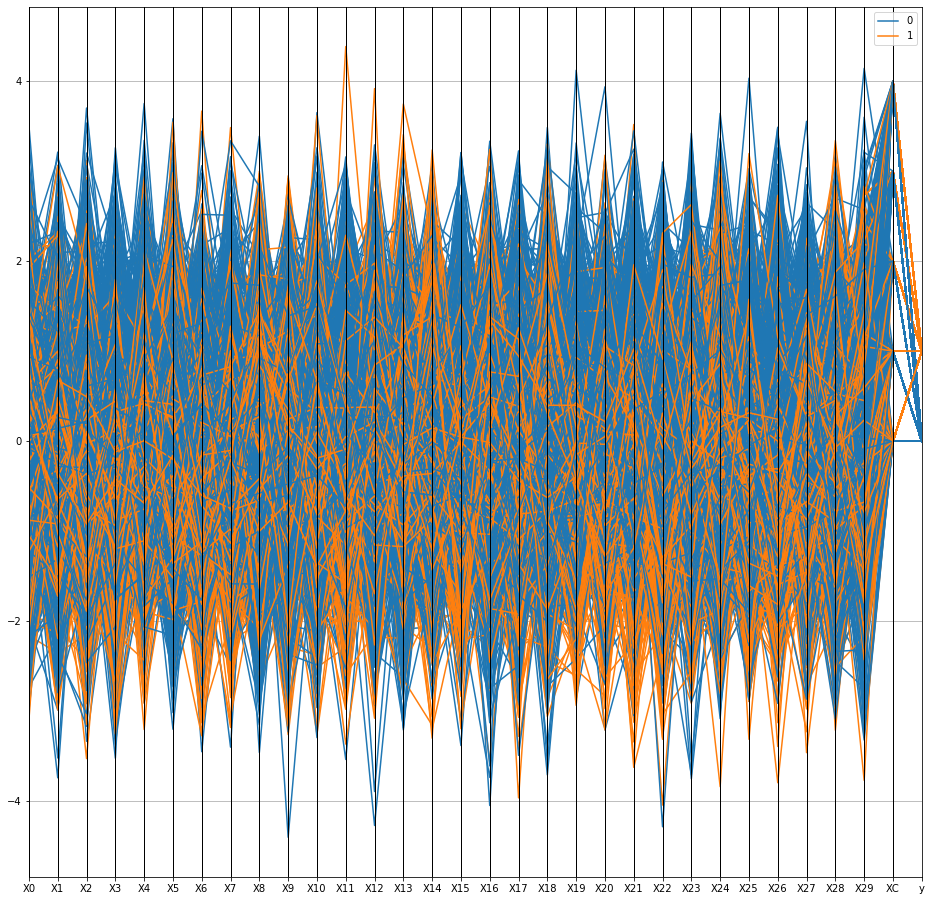

In [4]:
plt.figure(figsize=(16,16))
pd.plotting.parallel_coordinates(feat_df, 'y', cols=feat_df.columns, color=cm.tab10.colors)
plt.show()

The graph above is difficult to observe because of the sheer number of data samples plotted. Let's see if we can reduce the clutter by plotting 5 features at a time.

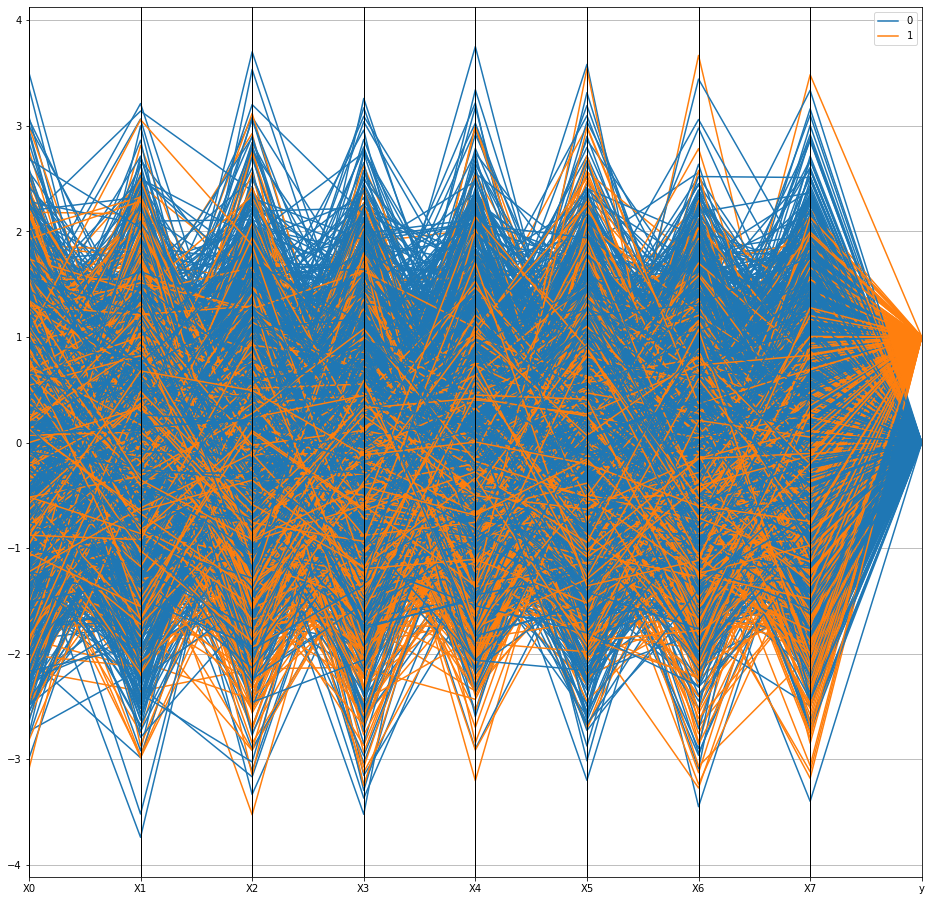

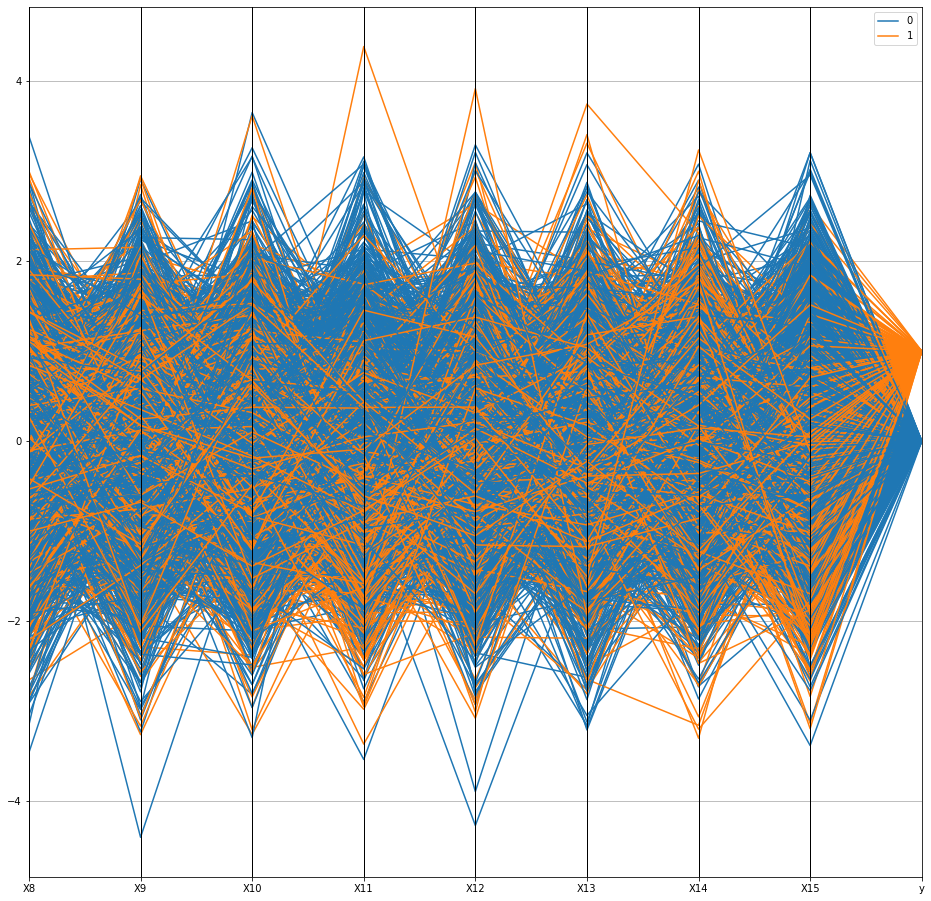

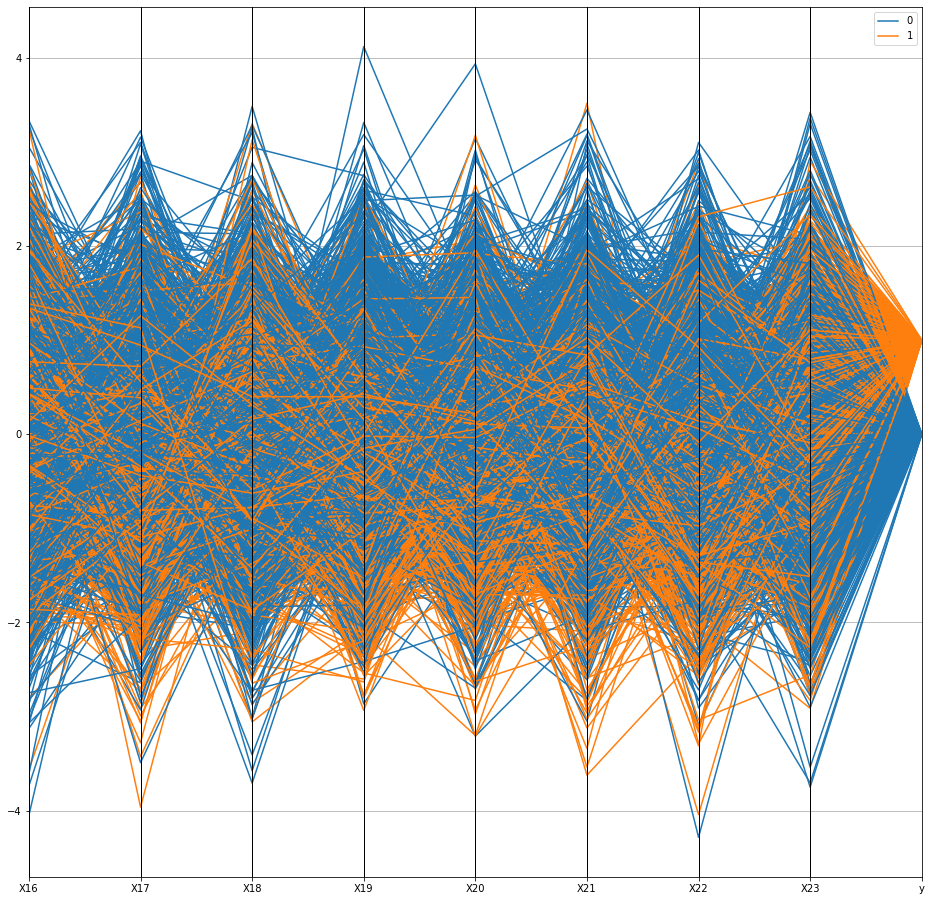

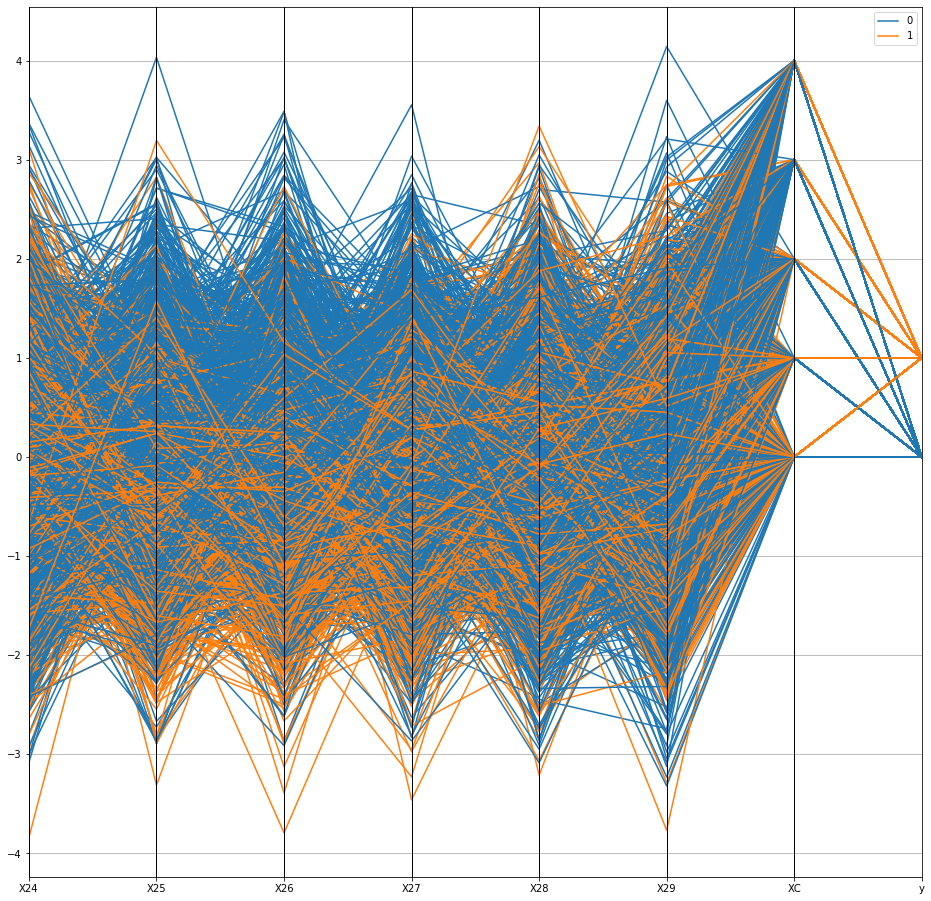

In [5]:
for i in range(4):
    plt.figure(figsize=(16,16))
    sub_feat_df = feat_df.iloc[:, i*8: (i+1)*8]
    sub_feat_df['y'] = df['y']
    pd.plotting.parallel_coordinates(sub_feat_df, 'y', cols=sub_feat_df.columns, color=cm.tab10.colors)
    plt.show()

Better, but still difficult to read, let's also try to reduce the data samples by randomly sampling 10% of each target labels.

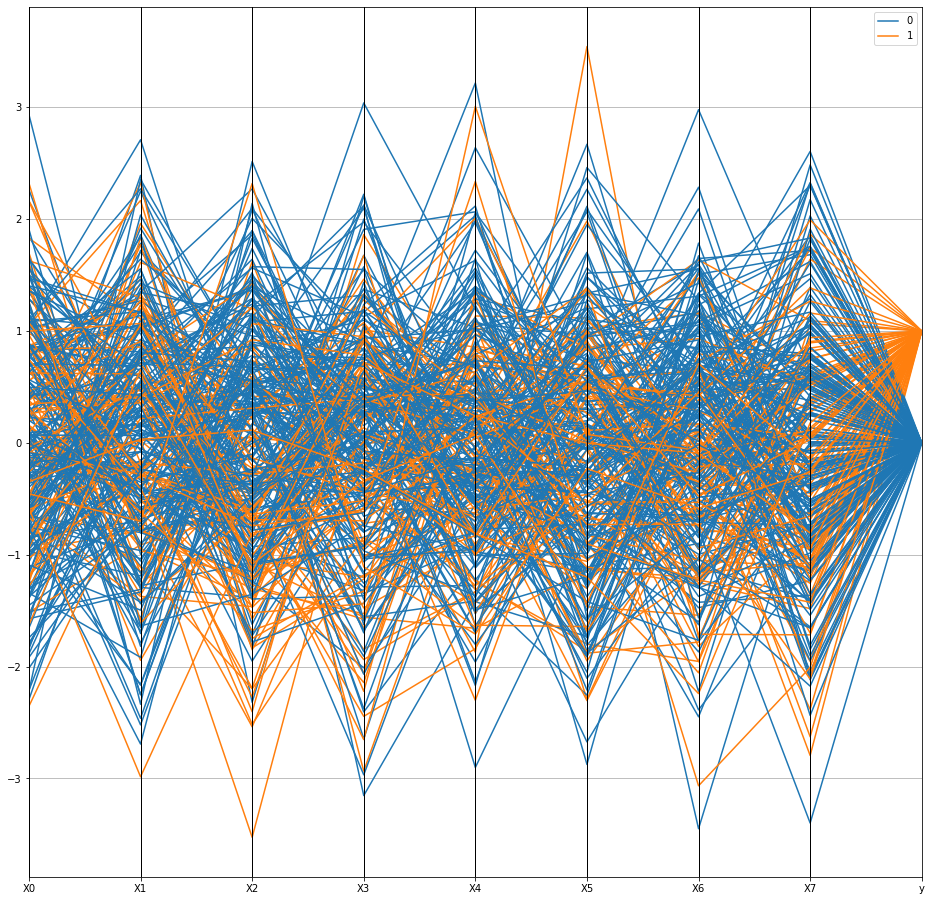

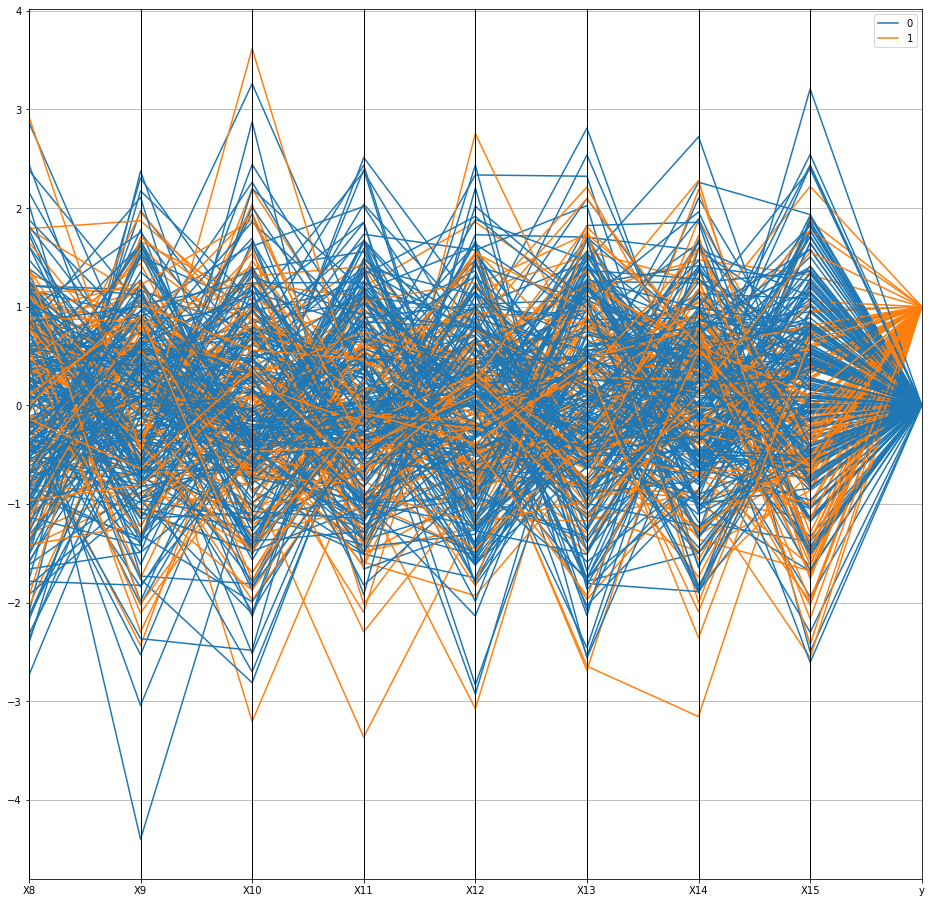

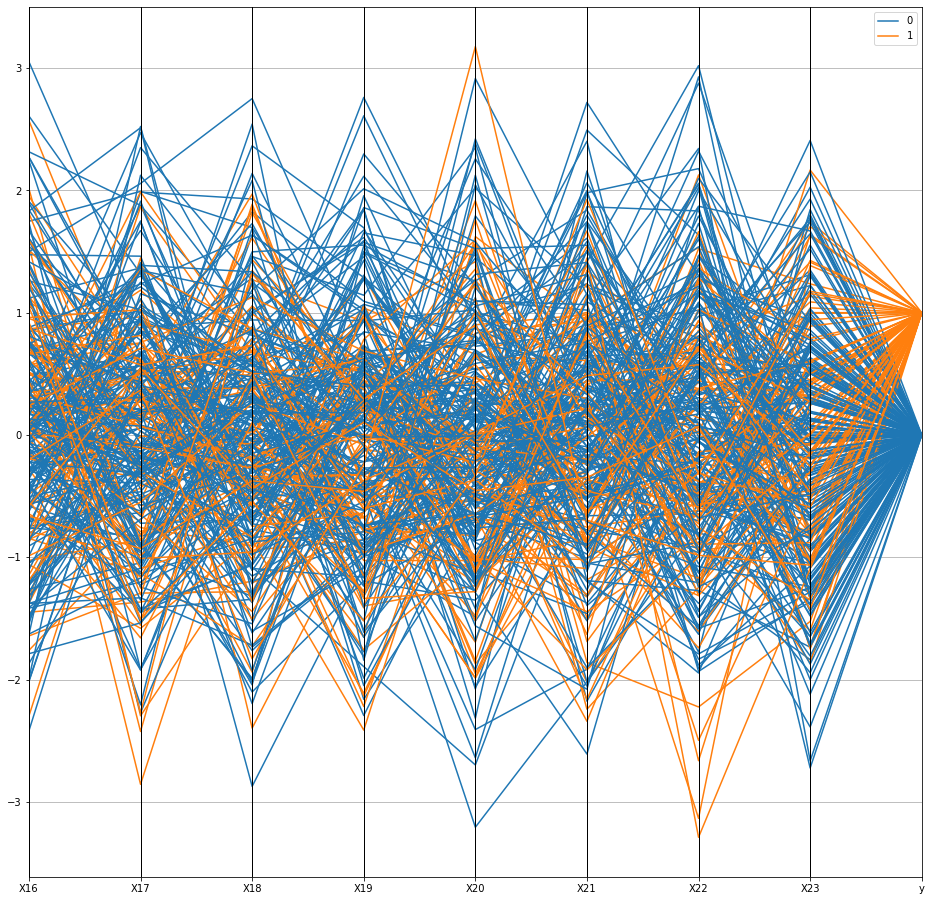

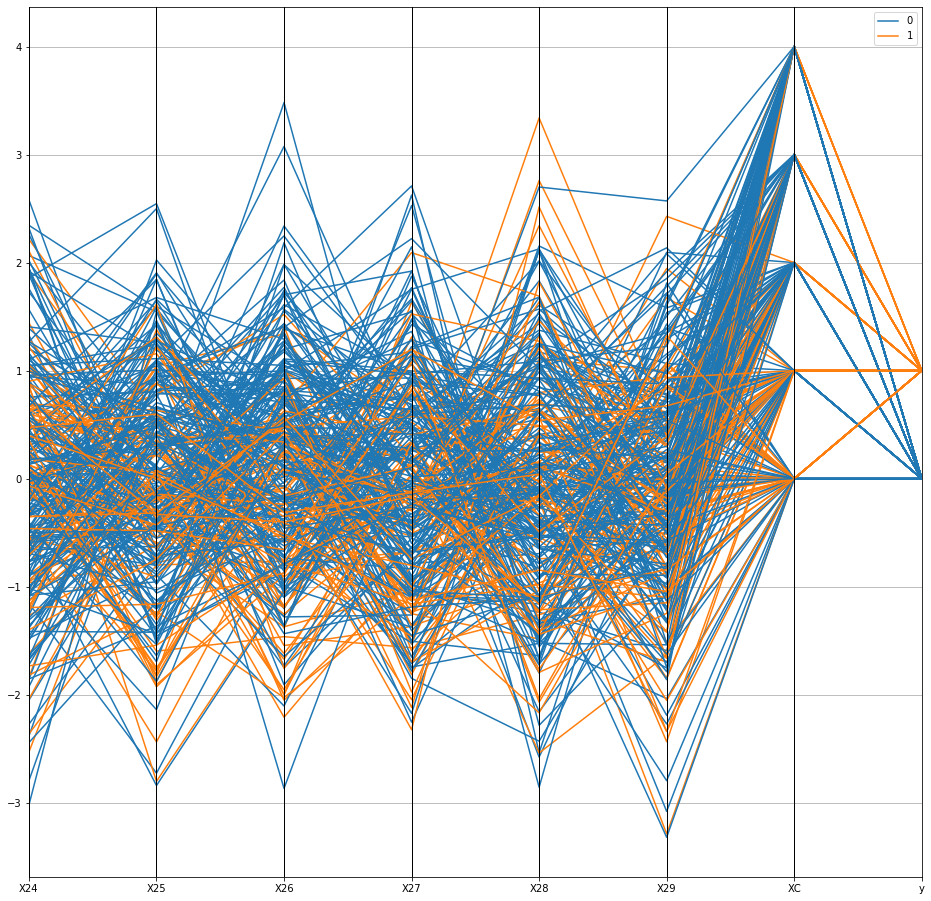

In [6]:
SAMPLE_RATE = .1

target_0_df = feat_df[feat_df.y == 0].sample(int(feat_df.y.value_counts()[0] * SAMPLE_RATE)) 
target_1_df = feat_df[feat_df.y == 1].sample(int(feat_df.y.value_counts()[1] * SAMPLE_RATE)) 
feat_df = target_0_df.append(target_1_df)
feat_df = feat_df.sample(frac=1) # Shuffle rows so that all the target label 0 lines are not on top

for i in range(4):
    plt.figure(figsize=(16,16))
    sub_feat_df = feat_df.iloc[:, i*8: (i+1)*8]
    sub_feat_df['y'] = df['y']
    pd.plotting.parallel_coordinates(sub_feat_df, 'y', cols=sub_feat_df.columns, color=cm.tab10.colors)
    plt.show()

After observing this graph, it's difficult to confidently conclude/assume much from this visualization. A rough observation would be that target label 0 features tend to have larger values, but overall it seems to appear quite randomly spread among features. A powerful classifier will be needed to discern features.

# Observing Relationships by Char Feature 'XC'
Although the classification task does not use the char feature column 'XC' as a class, I attempt to see if the char feature 'XC' is strongly correlated with the numerical features. If so, then this feature will also be correlated with the final binary classification label.

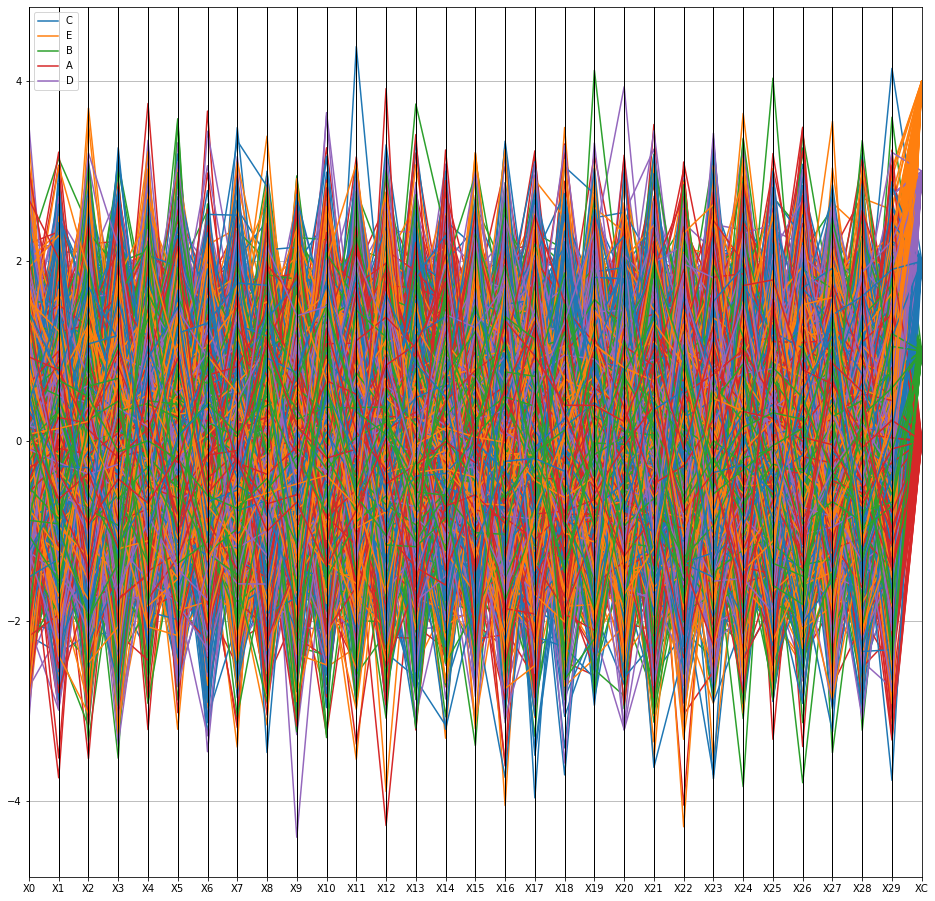

In [7]:
plt.figure(figsize=(16,16))
feat_df = df.drop(['y'], axis=1)
categ_mapping = dict(enumerate(feat_df.XC.astype('category').cat.categories))
feat_df.XC = feat_df.XC.astype('category').cat.codes
pd.plotting.parallel_coordinates(feat_df, 'XC', cols=feat_df.columns, color=cm.tab10.colors)

# Remap idx values to char value
legend = plt.legend()
for idx, item in enumerate(legend.get_texts()):
    legend.get_texts()[idx].set_text(categ_mapping[int(item.get_text())])
    
plt.show()

Again, the data is split into multiple graphs to display 5 features at a time.

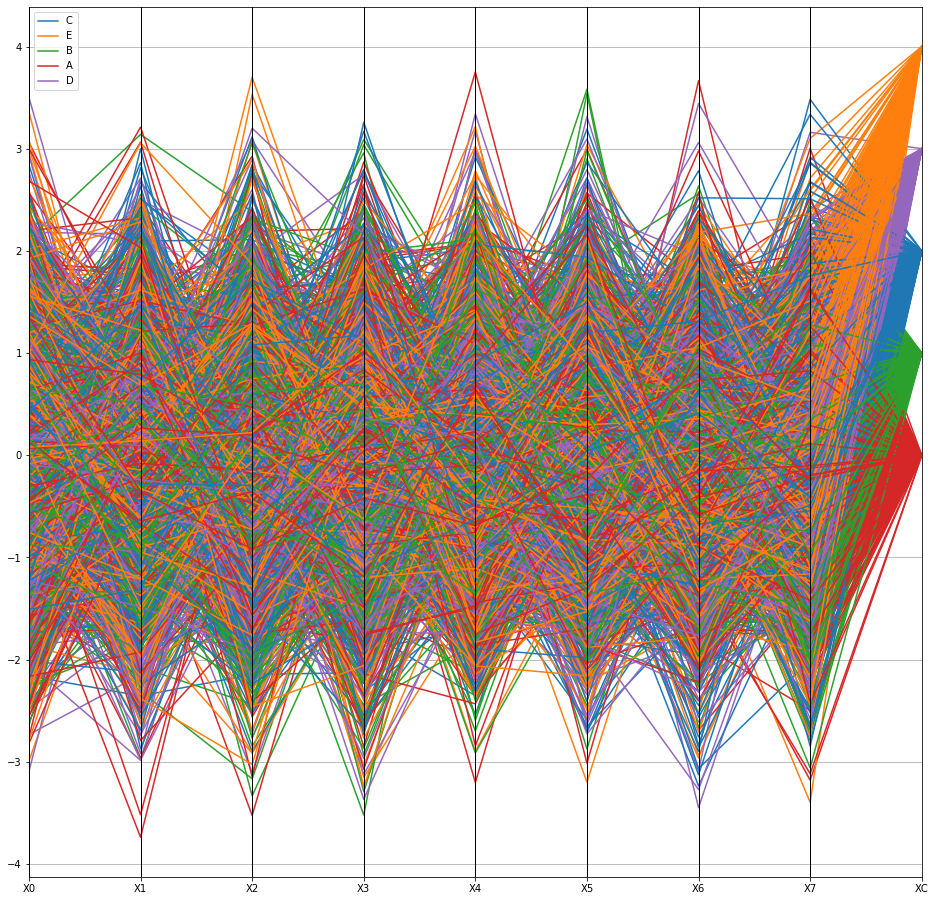

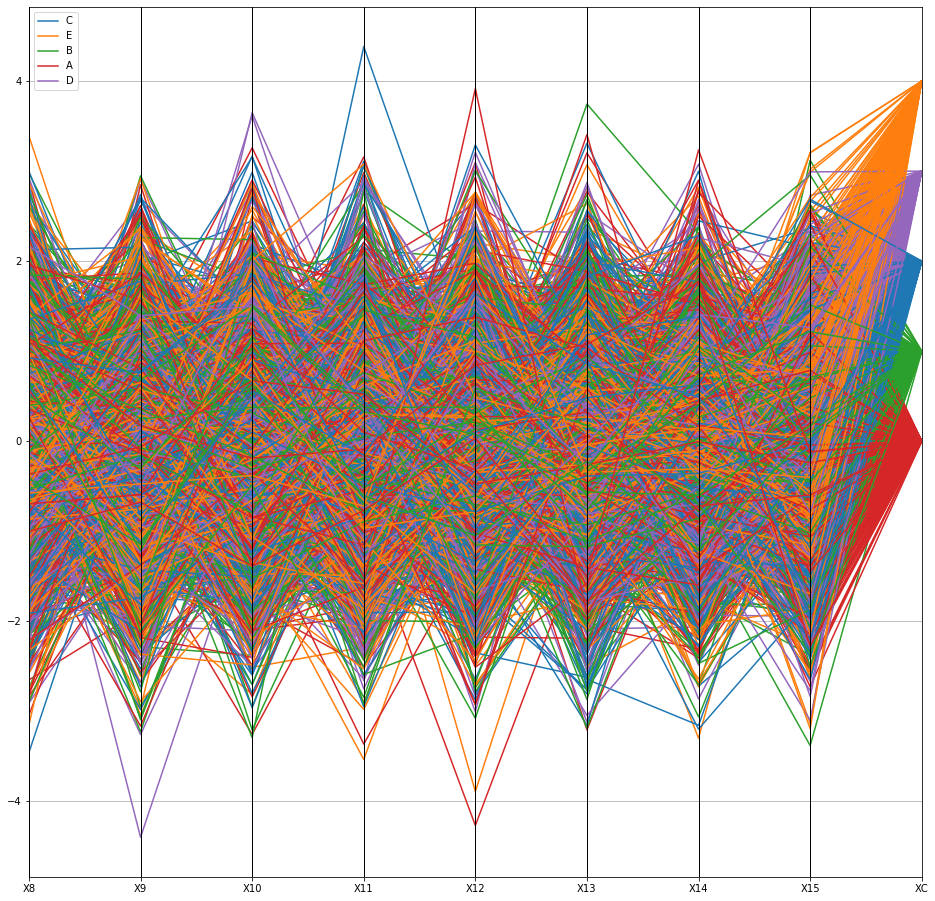

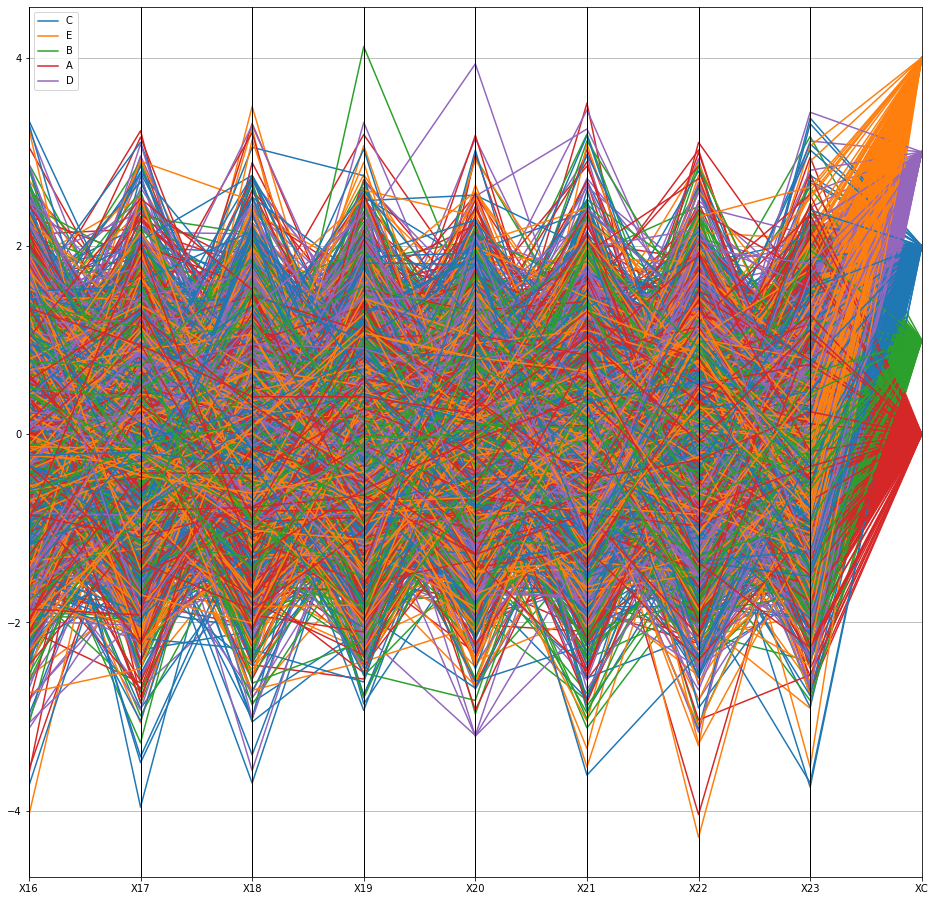

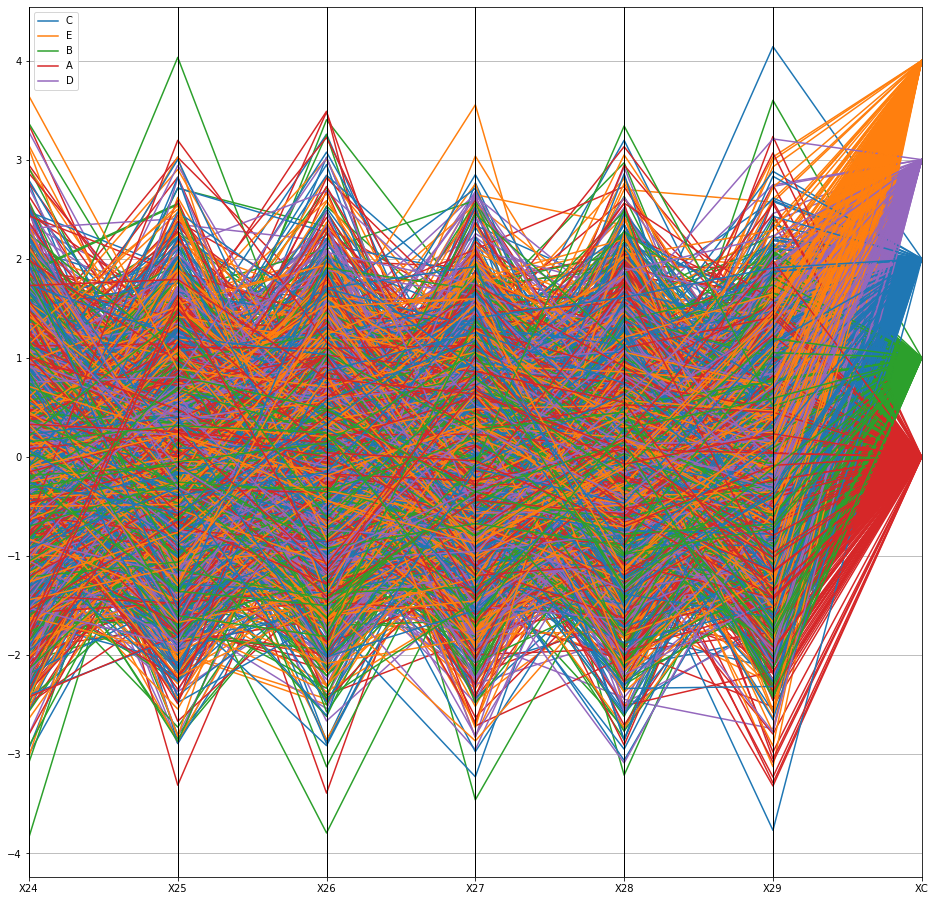

In [8]:
for i in range(4):
    plt.figure(figsize=(16,16))
    sub_feat_df = feat_df.iloc[:, i*8: (i+1)*8]
    sub_feat_df['XC'] = feat_df['XC']
    pd.plotting.parallel_coordinates(sub_feat_df, 'XC', cols=sub_feat_df.columns, color=cm.tab10.colors)
    
    # Remap idx values to char value
    legend = plt.legend()
    for idx, item in enumerate(legend.get_texts()):
        legend.get_texts()[idx].set_text(categ_mapping[int(item.get_text())])
    
    plt.show()

Again, 10% of each char featured data sample are displayed.

In [9]:
SAMPLE_RATE = .1

target_a_df = feat_df[feat_df.XC == 'A'].sample(int(feat_df.XC.value_counts()['A'] * SAMPLE_RATE)) 
target_b_df = feat_df[feat_df.XC == 'B'].sample(int(feat_df.XC.value_counts()['B'] * SAMPLE_RATE)) 
target_c_df = feat_df[feat_df.XC == 'C'].sample(int(feat_df.XC.value_counts()['C'] * SAMPLE_RATE)) 
target_d_df = feat_df[feat_df.XC == 'D'].sample(int(feat_df.XC.value_counts()['D'] * SAMPLE_RATE)) 
target_e_df = feat_df[feat_df.XC == 'E'].sample(int(feat_df.XC.value_counts()['E'] * SAMPLE_RATE)) 

feat_df = target_a_df.append(target_b_df)
feat_df = feat_df.append(target_c_df)
feat_df = feat_df.append(target_d_df)
feat_df = feat_df.append(target_e_df)
feat_df = feat_df.sample(frac=1) # Shuffle rows so that all the target label 0 lines are not on top
feat_df.XC = feat_df.XC.astype('category').cat.codes

for i in range(4):
    plt.figure(figsize=(16,16))
    sub_feat_df = feat_df.iloc[:, i*8: (i+1)*8]
    sub_feat_df['XC'] = feat_df['XC']
    pd.plotting.parallel_coordinates(sub_feat_df, 'XC', cols=sub_feat_df.columns, color=cm.tab10.colors)
    
    # Remap idx values to char value
    legend = plt.legend()
    for idx, item in enumerate(legend.get_texts()):
        legend.get_texts()[idx].set_text(categ_mapping[int(item.get_text())])
    
    plt.show()

C:\Users\HenryCWoo\Anaconda3\envs\wfc\lib\site-packages\pandas\core\ops\array_ops.py:253: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  res_values = method(rvalues)


KeyError: 'A'

Like when we tried to observe the relationships between features and target labels, this case where we observe relationships between the char feature and the other features also proves to be difficult to observe using the Parallel Coordinates method. There does not seem to be an obvious relationship in this demonstration.

Due to the data's high overlap and no easily perceptable patterns in the data, I can conclude that this visualization does not allow me to find obvious relationships between data points if one exists.